# Voice conversion prototyping

with GMMs; Arctic corpus

In [1]:
# open data
from os.path import join, expanduser
DATA_ROOT = join(expanduser("~"), "Documents/em_lct/UoM/thesis/data", "arctic2")
!ls $DATA_ROOT

BDL  CLB  EBVS HKK  NJS  RRBI TNI  YDCK


In [2]:
# nnmnkwii imports taken from example notebook on VC
%pylab inline
rcParams["figure.figsize"] = (16,5)

from nnmnkwii.datasets import PaddedFileSourceDataset, FileDataSource
# from nnmnkwii.datasets.cmu_arctic import CMUArcticWavFileDataSource
from nnmnkwii.preprocessing.alignment import DTWAligner
from nnmnkwii.preprocessing import trim_zeros_frames, remove_zeros_frames, delta_features
from nnmnkwii.util import apply_each2d_trim
from nnmnkwii.metrics import melcd
from nnmnkwii.baseline.gmm import MLPG

from os import listdir
from os.path import basename, splitext, join, splitext, isdir
import sys
import time

import numpy as np
import pandas as pd
from scipy.io import wavfile
from scipy import signal
from sklearn.mixture import GaussianMixture
from sklearn.model_selection import train_test_split
from sklearn.cluster import KMeans
import pyworld
import pysptk
from pysptk.synthesis import MLSADF, Synthesizer
import librosa
import librosa.display
import IPython
from IPython.display import Audio

Populating the interactive namespace from numpy and matplotlib


/Users/kennylino/.local/share/virtualenvs/thesis-W2ZHkp3l/lib/python3.6/importlib/_bootstrap.py:219: RuntimeWarning: numpy.dtype size changed, may indicate binary incompatibility. Expected 96, got 88
  return f(*args, **kwds)


In [3]:
fs = 16000
fftlen = pyworld.get_cheaptrick_fft_size(fs)
alpha = pysptk.util.mcepalpha(fs)
order = 24
frame_period = 5
hop_length = int(fs * (frame_period * 0.001))
max_files = 150 # number of utterances to be used.
test_size = 0.33
use_delta = True

if use_delta:
    windows = [
        (0, 0, np.array([1.0])),
        (1, 1, np.array([-0.5, 0.0, 0.5])),
        (1, 1, np.array([1.0, -2.0, 1.0])),
    ]
else:
    windows = [
        (0, 0, np.array([1.0])),
    ]

In [4]:
def _name_to_dirname(name):
    return join(name.upper(), "wav")

class ArcticFileDataSource(FileDataSource):
    """Wav file data source for CMU Arctic AND L2-ARCTIC dataset.
    
    Files were pre-organized into the same root folder before using this class.
    
    Code from https://r9y9.github.io/nnmnkwii/latest/_modules/nnmnkwii/datasets/cmu_arctic.html
    was modified to expand support to L2-ARCTIC.

    The data source collects wav files from CMU Arctic and L2-ARCTIC.
    Users are expected to inherit the class and implement ``collect_features``
    method, which defines how features are computed given a wav file path.

    Args:
        data_root (str): Data root.
        speakers (list): List of speakers to find. Supported names of speaker
         are any speakers in CMU Arctic and L2-ARCTIC corpus.
        labelmap (dict[optional]): Dict of speaker labels. If None,
          it's assigned as incrementally (i.e., 0, 1, 2) for specified
          speakers.
        max_files (int): Total number of files to be collected.

    Attributes:
        labels (numpy.ndarray): Speaker labels paired with collected files.
          Stored in ``collect_files``. This is useful to build multi-speaker
          models.
    """
  
    def __init__(self, data_root, speakers, labelmap=None, max_files=None):
        self.data_root = data_root
        self.speakers = speakers
        if labelmap is None:
            labelmap = {}
            for idx, speaker in enumerate(speakers):
                labelmap[speaker] = idx
        self.labelmap = labelmap
        self.max_files = max_files
        self.labels = None
        self.test_paths = None
        self.train_paths = None

    def collect_files(self):
        speaker_dirs = list(
            map(lambda x: join(self.data_root, _name_to_dirname(x)),
                self.speakers))
        paths = []
        labels = []

        if self.max_files is None:
            max_files_per_speaker = None
        else:
            max_files_per_speaker = self.max_files // len(self.speakers)
        for (i, d) in enumerate(speaker_dirs):
            if not isdir(d):
                raise RuntimeError("{} doesn't exist.".format(d))
            files = [join(speaker_dirs[i], f) for f in listdir(d)]
            files = list(filter(lambda x: splitext(x)[1] == ".wav", files))
            files = sorted(files)
            files = files[:max_files_per_speaker]
            for f in files:
                # add if statement here to say "if file id is also in other speaker folder"
                paths.append(f)
                labels.append(self.labelmap[self.speakers[i]])

        self.labels = np.array(labels, dtype=np.int32)
        
        paths_train, paths_test = train_test_split(
            paths, test_size=test_size, random_state=42)
        
        # keep paths for later testing
        self.train_paths = paths_train
        self.test_paths = paths_test
        
        return paths_train

    def collect_features(self, path):
        x, frame_sample = librosa.load(path, sr=fs, dtype=float64)
        f0, timeaxis = pyworld.dio(x, frame_sample, frame_period=frame_period)
        f0 = pyworld.stonemask(x, f0, timeaxis, frame_sample)
        spectrogram = pyworld.cheaptrick(x, f0, timeaxis, frame_sample)
        spectrogram = trim_zeros_frames(spectrogram)
        mc = pysptk.sp2mc(spectrogram, order=order, alpha=alpha)
        return mc

In [5]:
src_speaker = ArcticFileDataSource(data_root=DATA_ROOT, speakers=["BDL"], max_files=max_files)
tgt_speaker = ArcticFileDataSource(data_root=DATA_ROOT, speakers=["RRBI"], max_files=max_files) 

In [6]:
# convert training sets into arrays
X = PaddedFileSourceDataset(src_speaker, 1500).asarray()
Y = PaddedFileSourceDataset(tgt_speaker, 1500).asarray()
print(X.shape)
print(Y.shape) 
# shape = (13 training audios, 2800 frames, 25 features per frame)

(100, 1500, 25)
(100, 1500, 25)


In [7]:
import os.path

In [8]:
#Ensures that the audio files used for training and testing
# are all indeed parallel.
# Returns boolean.

def check_parallel_files(src_speaker, tgt_speaker):
    src_speaker_check = [os.path.split(f)[1][-16] for f in src_speaker] # -16 to remove speaker ID
    tgt_speaker_check = [os.path.split(f)[1][-16] for f in tgt_speaker] # -16 to remove speaker ID
    
    return src_speaker_check == tgt_speaker_check
        

In [9]:
check_parallel_files(src_speaker.train_paths, tgt_speaker.train_paths)

True

In [10]:
check_parallel_files(src_speaker.test_paths, tgt_speaker.test_paths)

True

In [11]:
# Plotting util
def plot_parallel(x,y):
    figure(figsize=(16,7))
    subplot(2,1,1)
    librosa.display.specshow(trim_zeros_frames(x).T, sr=fs, hop_length=hop_length, x_axis="time")
    colorbar()
    subplot(2,1,2)
    librosa.display.specshow(trim_zeros_frames(y).T, sr=fs, hop_length=hop_length, x_axis="time")
    colorbar()

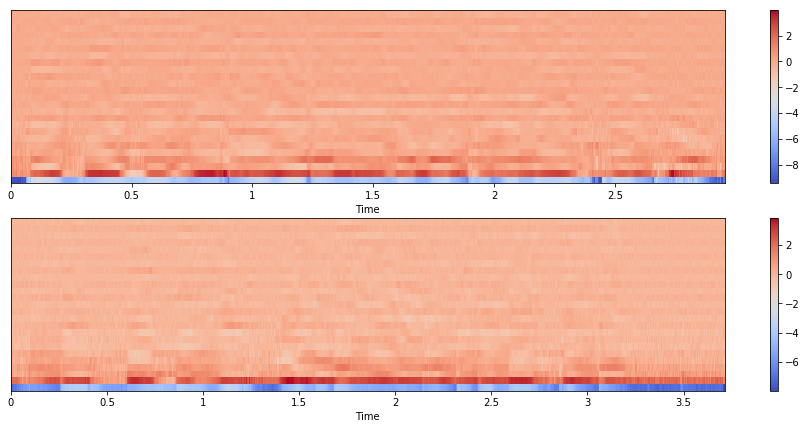

In [12]:
idx = 6 # any 
plot_parallel(X[idx],Y[idx])

In [13]:
# Alignment
X_aligned, Y_aligned = DTWAligner(verbose=0, dist=melcd).transform((X, Y))

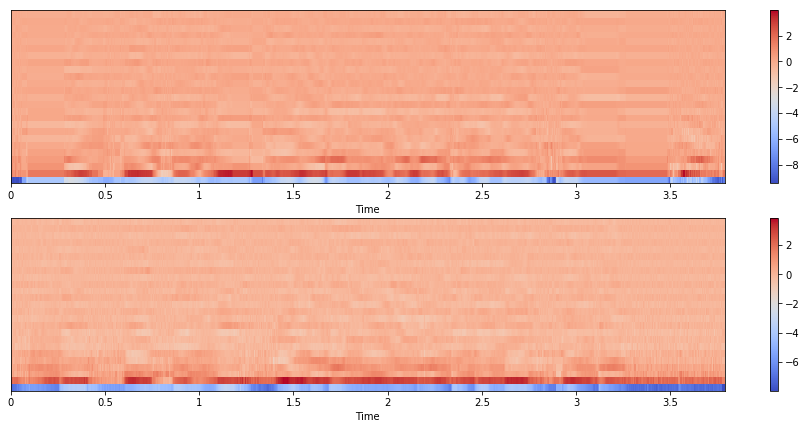

In [14]:
plot_parallel(X_aligned[idx],Y_aligned[idx])

In [15]:
# Drop 1st (power) dimension
X_aligned, Y_aligned = X_aligned[:, :, 1:], Y_aligned[:, :, 1:]

In [16]:
static_dim = X_aligned.shape[-1]
if use_delta:
    X_aligned = apply_each2d_trim(delta_features, X_aligned, windows)
    Y_aligned = apply_each2d_trim(delta_features, Y_aligned, windows)

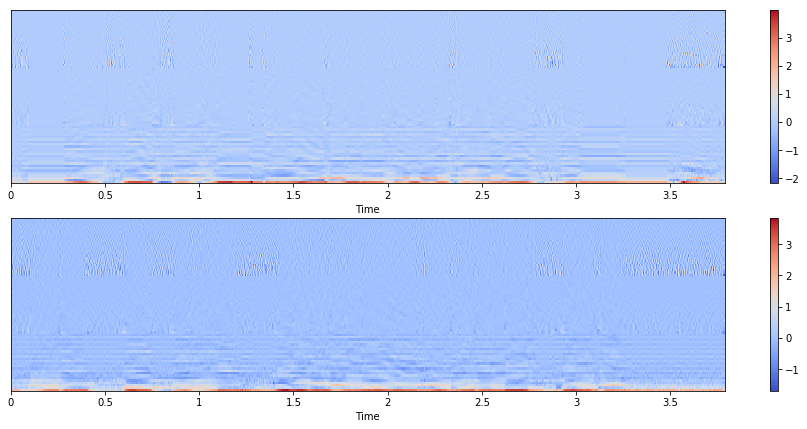

In [17]:
plot_parallel(X_aligned[idx],Y_aligned[idx])

## Kmeans clustering of MFCC feature vectors

### clustering of source speaker

In [18]:
km_X = KMeans(n_clusters=512, init='k-means++', max_iter=100, n_init=1)

In [19]:
X_aligned.shape

(100, 1500, 72)

In [20]:
# concatenates all of the frames in each sentence since k-means needs one large vector
all_frames_X = numpy.concatenate(X_aligned, axis=0)

In [21]:
# should equal number of frames * number of utterances
len(all_frames_X)

150000

In [22]:
all_frames_X.shape

(150000, 72)

In [23]:
all_frames_X[0]

array([ 6.80645466e-01,  4.52154011e-01,  4.85359073e-01, -1.14714630e-01,
       -3.50598216e-01, -1.57449722e-01, -1.30261496e-01,  3.25970978e-01,
       -7.56070483e-03, -1.88170969e-01,  2.53370434e-01, -1.28385529e-01,
       -7.25669116e-02,  8.75799134e-02,  1.51372235e-03, -2.30644960e-02,
        4.81543364e-03, -6.15001773e-04,  2.07221657e-02, -5.65095991e-02,
        7.07060099e-02, -6.29694462e-02,  5.27017117e-02, -3.74574326e-02,
        4.11681324e-01,  2.96513379e-01,  5.03479660e-01,  1.43218920e-01,
       -5.64718060e-02, -4.27100360e-02,  1.58435125e-02, -1.12557717e-01,
       -2.16256268e-03, -2.75595412e-02,  4.66486216e-02, -1.78021416e-02,
       -6.21525273e-02,  5.15491962e-02,  3.43296165e-03, -4.00132537e-02,
        3.92224267e-02, -2.60130838e-02,  2.68814620e-02, -1.90515984e-02,
        2.48402990e-02, -2.12073158e-02,  2.40097530e-02, -2.90453490e-02,
       -5.37928283e-01, -3.11281264e-01,  3.62411737e-02,  5.15867114e-01,
        5.88252842e-01,  

In [24]:
# 0 frames are removed since they are all exactly the same
all_frames_X = remove_zeros_frames(all_frames_X)

In [25]:
len(all_frames_X)

73971

In [26]:
%%time
km_X.fit(all_frames_X)

CPU times: user 1min 20s, sys: 25.7 s, total: 1min 45s
Wall time: 1min 1s


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=100,
    n_clusters=512, n_init=1, n_jobs=1, precompute_distances='auto',
    random_state=None, tol=0.0001, verbose=0)

In [27]:
# help taken from: https://stackoverflow.com/questions/36195457/python-sklearn-kmeans-how-to-get-the-values-in-the-cluster
clustered_X = pd.DataFrame()
clustered_X['frame'] = all_frames_X.tolist()
clustered_X['cluster #'] = km_X.labels_

In [28]:
clustered_X.head()

,frame,cluster #
0,"[0.6806454658508301, 0.4521540105342865, 0.485...",509
1,"[0.8233626484870911, 0.5930267572402954, 1.006...",237
2,"[0.9945943355560303, 0.6802266836166382, 0.425...",405
3,"[0.868552565574646, 0.41492757201194763, 0.184...",196
4,"[1.2008333206176758, 0.6673847436904907, 0.544...",371


In [29]:
cluster_dist_X = clustered_X.groupby('cluster #').size()

In [30]:
# use print(cluster_dist_X.to_string()) to see whole dist
print (cluster_dist_X.head)

<bound method NDFrame.head of cluster #
0      149
1       67
2      147
3      203
4      112
5      109
6      187
7      280
8      227
9       63
10      99
11     203
12      75
13      88
14     402
15     206
16     122
17      88
18     290
19     254
20     129
21     215
22     268
23      85
24     184
25     280
26     207
27     217
28     142
29      41
      ... 
482     77
483    256
484     87
485     80
486    131
487    207
488     76
489    130
490     67
491     90
492     74
493    168
494     90
495    250
496    227
497    132
498     86
499    107
500    139
501    103
502    144
503    208
504    167
505    128
506    113
507    107
508    168
509     89
510     48
511     49
Length: 512, dtype: int64>


In [31]:
cluster_dist_X.describe()

count    512.000000
mean     144.474609
std       76.496366
min        7.000000
25%       84.000000
50%      130.500000
75%      198.250000
max      409.000000
dtype: float64

### Clustering of the target speaker data

In [32]:
km_Y = KMeans(n_clusters=512, init='k-means++', max_iter=100, n_init=1)

In [33]:
# concatenates all of the frames in each sentence since k-means needs one large vector
all_frames_Y = numpy.concatenate(Y_aligned, axis=0)

In [34]:
# should equal number of frames * number of utterances
len(all_frames_Y)

150000

In [35]:
all_frames_Y.shape

(150000, 72)

In [36]:
test = all_frames_Y[0]

In [37]:
# 0 frames are removed since they are all exactly the same
all_frames_Y = remove_zeros_frames(all_frames_Y)

In [38]:
%%time
km_Y.fit(all_frames_Y)

CPU times: user 1min 26s, sys: 28.4 s, total: 1min 55s
Wall time: 1min 8s


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=100,
    n_clusters=512, n_init=1, n_jobs=1, precompute_distances='auto',
    random_state=None, tol=0.0001, verbose=0)

In [39]:
# help taken from: https://stackoverflow.com/questions/36195457/python-sklearn-kmeans-how-to-get-the-values-in-the-cluster
clustered_Y = pd.DataFrame()
clustered_Y['frame'] = all_frames_Y.tolist()
clustered_Y['cluster #'] = km_Y.labels_

In [40]:
clustered_Y.head()

,frame,cluster #
0,"[1.1868687868118286, 0.23256246745586395, -0.1...",152
1,"[2.047870635986328, 1.0603821277618408, 0.4540...",498
2,"[1.9870866537094116, 0.8947755098342896, 0.558...",430
3,"[1.9077324867248535, 0.8591958284378052, 0.493...",94
4,"[1.8272154331207275, 0.6681551933288574, 0.617...",286


In [41]:
cluster_dist_Y = clustered_Y.groupby('cluster #').size()

In [42]:
# use print(cluster_dist_Y.to_string()) to see whole dist
print (cluster_dist_Y.head)

<bound method NDFrame.head of cluster #
0      193
1       98
2      131
3      140
4      106
5      103
6      278
7      105
8      245
9      102
10     205
11     122
12     120
13      88
14     304
15     143
16     138
17      63
18     189
19      81
20      84
21     112
22     105
23     231
24     195
25     264
26     262
27     188
28     301
29     193
      ... 
482     94
483     67
484     86
485    217
486     87
487    117
488     87
489     75
490     87
491    163
492     62
493     71
494     51
495    315
496     86
497    319
498     58
499    203
500    225
501     37
502     88
503    116
504     79
505    172
506    189
507    164
508    101
509    237
510     88
511    320
Length: 512, dtype: int64>


In [43]:
cluster_dist_Y.describe()

count    512.000000
mean     144.474609
std       76.852690
min       18.000000
25%       88.000000
50%      113.500000
75%      193.500000
max      440.000000
dtype: float64

### Building the look-up table

In [44]:
%%time
# shape = (13 training audios, 2800 frames, 25 features per frame)

# all_frames_x contains each frame from each audio inside of X (aka X_aligned)

# the psuedocode for finding closest frames 
# for frame in all_frames_X:
#    predict the cluster of the frame in clustered_Y
#    find the closest data point in clustered_Y to frame
#    store X_frame and most similar frame, Y_frame in paired_frames_X

from scipy import spatial

# bytes version of X: array from Y
paired_frames_X = {}

for frame in all_frames_X:
    # needs to be reshaped to shape of km training data 
    frame_pred = frame.reshape(1, -1)
    predicted_cluster = km_Y.predict(frame_pred)[0] # returns cluster num
    # grabs the possible frames and converts them to the proper array format for KDTree
    possible_frames = (clustered_Y[clustered_Y['cluster #'] == predicted_cluster]['frame'].values).tolist()
    tree = spatial.KDTree(possible_frames)
    # tree.query() returns (the distance between the closest frame and index in series)
    most_similar = tree.query(frame)
    most_similar_vec = np.array(possible_frames[most_similar[1]]) # index in possible_frames
    frame_key = frame.tobytes() # converted to bytes since arrays cannot be keys
    paired_frames_X[frame_key] = most_similar_vec  

CPU times: user 14min 25s, sys: 2min 34s, total: 16min 59s
Wall time: 4min 16s


In [45]:
# creates the 'most similar to X' array
Y = np.array([paired_frames_X[frame.tobytes()] for frame in all_frames_X])

In [46]:
XY = np.concatenate((all_frames_X, Y), axis=-1)
print(XY.shape)

(73971, 144)


## GMM training

In [47]:
# trains the GMM between the L1 and L2 speaker
gmm = GaussianMixture(
    n_components=128, covariance_type="full", max_iter=100, verbose=1)

%time gmm.fit(XY)

Initialization 0
  Iteration 0
  Iteration 10
  Iteration 20
  Iteration 30
  Iteration 40
  Iteration 50
Initialization converged: True
CPU times: user 1h 49min, sys: 19min 35s, total: 2h 8min 35s
Wall time: 32min 32s


GaussianMixture(covariance_type='full', init_params='kmeans', max_iter=100,
        means_init=None, n_components=128, n_init=1, precisions_init=None,
        random_state=None, reg_covar=1e-06, tol=0.001, verbose=1,
        verbose_interval=10, warm_start=False, weights_init=None)

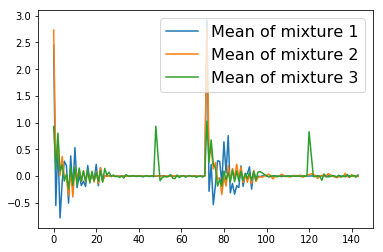

In [48]:
for k in range(3):
    plot(gmm.means_[k], linewidth=1.5, label="Mean of mixture {}".format(k+1))
legend(prop={"size": 16})

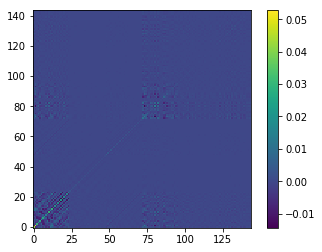

In [49]:
imshow(gmm.covariances_[0], origin="bottom left")
colorbar()

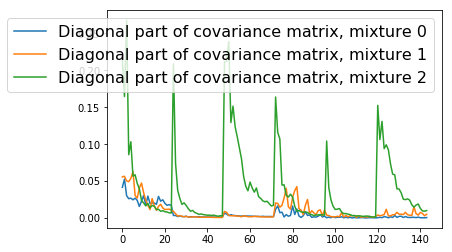

In [50]:
for k in range(3):
    plot(np.diag(gmm.covariances_[k]), linewidth=1.5, 
         label="Diagonal part of covariance matrix, mixture {}".format(k))
legend(prop={"size": 16})

In [51]:
def test_one_utt(src_path, tgt_path, disable_mlpg=False, diffvc=True):
    # GMM-based parameter generation is provided by the library in `baseline` module
    if disable_mlpg:
        # Force disable MLPG
        paramgen = MLPG(gmm, windows=[(0,0, np.array([1.0]))], diff=diffvc)
    else:
        paramgen = MLPG(gmm, windows=windows, diff=diffvc)

    x, frame_sample = librosa.load(src_path, sr=fs, dtype=float64)
    f0, timeaxis = pyworld.dio(x, frame_sample, frame_period=frame_period)
    f0 = pyworld.stonemask(x, f0, timeaxis, frame_sample)
    spectrogram = pyworld.cheaptrick(x, f0, timeaxis, frame_sample)
    aperiodicity = pyworld.d4c(x, f0, timeaxis, frame_sample)

    mc = pysptk.sp2mc(spectrogram, order=order, alpha=alpha)
    c0, mc = mc[:, 0], mc[:, 1:]
    if use_delta:
        mc = delta_features(mc, windows)
    mc = paramgen.transform(mc)
    if disable_mlpg and mc.shape[-1] != static_dim:
        mc = mc[:,:static_dim]
    assert mc.shape[-1] == static_dim
    mc = np.hstack((c0[:, None], mc))
    if diffvc:
        mc[:, 0] = 0 # remove power coefficients
        engine = Synthesizer(MLSADF(order=order, alpha=alpha), hopsize=hop_length)
        b = pysptk.mc2b(mc.astype(np.float64), alpha=alpha)
        waveform = engine.synthesis(x, b)
    else:
        spectrogram = pysptk.mc2sp(
            mc.astype(np.float64), alpha=alpha, fftlen=fftlen)
        waveform = pyworld.synthesize(
            f0, spectrogram, aperiodicity, frame_sample, frame_period)
        
    return waveform

Compare results with [this](http://people.tamu.edu/~guanlong.zhao/icassp18_demo.html)

In [52]:
for i, (src_path, tgt_path) in enumerate(zip(src_speaker.test_paths, tgt_speaker.test_paths)):
    print("{}-th sample".format(i+1))
    wo_MLPG = test_one_utt(src_path, tgt_path, disable_mlpg=True)
    w_MLPG = test_one_utt(src_path, tgt_path, disable_mlpg=False)
    src, _ = librosa.load(src_path, sr=fs, dtype=float64)
    tgt, _ = librosa.load(tgt_path, sr=fs, dtype=float64)
    
    print("Source:", basename(src_path))
    IPython.display.display(Audio(src, rate=fs))
    print("Target:", basename(tgt_path))
    IPython.display.display(Audio(tgt, rate=fs))
    print("w/o MLPG")
    IPython.display.display(Audio(wo_MLPG, rate=fs))
    print("w/ MLPG")
    IPython.display.display(Audio(w_MLPG, rate=fs))

1-th sample
Source: BDL_arctic_a0074.wav


Target: RRBI_arctic_a0074.wav


w/o MLPG


w/ MLPG


2-th sample
Source: BDL_arctic_a0019.wav


Target: RRBI_arctic_a0019.wav


w/o MLPG


w/ MLPG


3-th sample
Source: BDL_arctic_a0119.wav


Target: RRBI_arctic_a0119.wav


w/o MLPG


w/ MLPG


4-th sample
Source: BDL_arctic_a0079.wav


Target: RRBI_arctic_a0079.wav


w/o MLPG


w/ MLPG


5-th sample
Source: BDL_arctic_a0077.wav


Target: RRBI_arctic_a0077.wav


w/o MLPG


w/ MLPG


6-th sample
Source: BDL_arctic_a0032.wav


Target: RRBI_arctic_a0032.wav


w/o MLPG


w/ MLPG


7-th sample
Source: BDL_arctic_a0065.wav


Target: RRBI_arctic_a0065.wav


w/o MLPG


w/ MLPG


8-th sample
Source: BDL_arctic_a0142.wav


Target: RRBI_arctic_a0142.wav


w/o MLPG


w/ MLPG


9-th sample
Source: BDL_arctic_a0069.wav


Target: RRBI_arctic_a0069.wav


w/o MLPG


w/ MLPG


10-th sample
Source: BDL_arctic_a0083.wav


Target: RRBI_arctic_a0083.wav


w/o MLPG


w/ MLPG


11-th sample
Source: BDL_arctic_a0111.wav


Target: RRBI_arctic_a0111.wav


w/o MLPG


w/ MLPG


12-th sample
Source: BDL_arctic_a0013.wav


Target: RRBI_arctic_a0013.wav


w/o MLPG


w/ MLPG


13-th sample
Source: BDL_arctic_a0037.wav


Target: RRBI_arctic_a0037.wav


w/o MLPG


w/ MLPG


14-th sample
Source: BDL_arctic_a0010.wav


Target: RRBI_arctic_a0010.wav


w/o MLPG


w/ MLPG


15-th sample
Source: BDL_arctic_a0020.wav


Target: RRBI_arctic_a0020.wav


w/o MLPG


w/ MLPG


16-th sample
Source: BDL_arctic_a0057.wav


Target: RRBI_arctic_a0057.wav


w/o MLPG


w/ MLPG


17-th sample
Source: BDL_arctic_a0105.wav


Target: RRBI_arctic_a0105.wav


w/o MLPG


w/ MLPG


18-th sample
Source: BDL_arctic_a0070.wav


Target: RRBI_arctic_a0070.wav


w/o MLPG


w/ MLPG


19-th sample
Source: BDL_arctic_a0056.wav


Target: RRBI_arctic_a0056.wav


w/o MLPG


w/ MLPG


20-th sample
Source: BDL_arctic_a0133.wav


Target: RRBI_arctic_a0133.wav


w/o MLPG


w/ MLPG


21-th sample
Source: BDL_arctic_a0030.wav


Target: RRBI_arctic_a0030.wav


w/o MLPG


w/ MLPG


22-th sample
Source: BDL_arctic_a0128.wav


Target: RRBI_arctic_a0128.wav


w/o MLPG


w/ MLPG


23-th sample
Source: BDL_arctic_a0027.wav


Target: RRBI_arctic_a0027.wav


w/o MLPG


w/ MLPG


24-th sample
Source: BDL_arctic_a0129.wav


Target: RRBI_arctic_a0129.wav


w/o MLPG


w/ MLPG


25-th sample
Source: BDL_arctic_a0132.wav


Target: RRBI_arctic_a0132.wav


w/o MLPG


w/ MLPG


26-th sample
Source: BDL_arctic_a0146.wav


Target: RRBI_arctic_a0146.wav


w/o MLPG


w/ MLPG


27-th sample
Source: BDL_arctic_a0109.wav


Target: RRBI_arctic_a0109.wav


w/o MLPG


w/ MLPG


28-th sample
Source: BDL_arctic_a0144.wav


Target: RRBI_arctic_a0144.wav


w/o MLPG


w/ MLPG


29-th sample
Source: BDL_arctic_a0046.wav


Target: RRBI_arctic_a0046.wav


w/o MLPG


w/ MLPG


30-th sample
Source: BDL_arctic_a0031.wav


Target: RRBI_arctic_a0031.wav


w/o MLPG


w/ MLPG


31-th sample
Source: BDL_arctic_a0023.wav


Target: RRBI_arctic_a0023.wav


w/o MLPG


w/ MLPG


32-th sample
Source: BDL_arctic_a0016.wav


Target: RRBI_arctic_a0016.wav


w/o MLPG


w/ MLPG


33-th sample
Source: BDL_arctic_a0066.wav


Target: RRBI_arctic_a0066.wav


w/o MLPG


w/ MLPG


34-th sample
Source: BDL_arctic_a0012.wav


Target: RRBI_arctic_a0012.wav


w/o MLPG


w/ MLPG


35-th sample
Source: BDL_arctic_a0043.wav


Target: RRBI_arctic_a0043.wav


w/o MLPG


w/ MLPG


36-th sample
Source: BDL_arctic_a0147.wav


Target: RRBI_arctic_a0147.wav


w/o MLPG


w/ MLPG


37-th sample
Source: BDL_arctic_a0052.wav


Target: RRBI_arctic_a0052.wav


w/o MLPG


w/ MLPG


38-th sample
Source: BDL_arctic_a0028.wav


Target: RRBI_arctic_a0028.wav


w/o MLPG


w/ MLPG


39-th sample
Source: BDL_arctic_a0005.wav


Target: RRBI_arctic_a0005.wav


w/o MLPG


w/ MLPG


40-th sample
Source: BDL_arctic_a0033.wav


Target: RRBI_arctic_a0033.wav


w/o MLPG


w/ MLPG


41-th sample
Source: BDL_arctic_a0143.wav


Target: RRBI_arctic_a0143.wav


w/o MLPG


w/ MLPG


42-th sample
Source: BDL_arctic_a0086.wav


Target: RRBI_arctic_a0086.wav


w/o MLPG


w/ MLPG


43-th sample
Source: BDL_arctic_a0087.wav


Target: RRBI_arctic_a0087.wav


w/o MLPG


w/ MLPG


44-th sample
Source: BDL_arctic_a0017.wav


Target: RRBI_arctic_a0017.wav


w/o MLPG


w/ MLPG


45-th sample
Source: BDL_arctic_a0011.wav


Target: RRBI_arctic_a0011.wav


w/o MLPG


w/ MLPG


46-th sample
Source: BDL_arctic_a0082.wav


Target: RRBI_arctic_a0082.wav


w/o MLPG


w/ MLPG


47-th sample
Source: BDL_arctic_a0134.wav


Target: RRBI_arctic_a0134.wav


w/o MLPG


w/ MLPG


48-th sample
Source: BDL_arctic_a0138.wav


Target: RRBI_arctic_a0138.wav


w/o MLPG


w/ MLPG


49-th sample
Source: BDL_arctic_a0076.wav


Target: RRBI_arctic_a0076.wav


w/o MLPG


w/ MLPG


50-th sample
Source: BDL_arctic_a0110.wav


Target: RRBI_arctic_a0110.wav


w/o MLPG


w/ MLPG
